In [ ]:
from google.colab import files
files.upload()

Saving diabetes_012_health_indicators_BRFSS2015.csv to diabetes_012_health_indicators_BRFSS2015.csv


{'diabetes_012_health_indicators_BRFSS2015.csv': b'Diabetes_012,HighBP,HighChol,CholCheck,BMI,Smoker,Stroke,HeartDiseaseorAttack,PhysActivity,Fruits,Veggies,HvyAlcoholConsump,AnyHealthcare,NoDocbcCost,GenHlth,MentHlth,PhysHlth,DiffWalk,Sex,Age,Education,Income\n0.0,1.0,1.0,1.0,40.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,5.0,18.0,15.0,1.0,0.0,9.0,4.0,3.0\n0.0,0.0,0.0,0.0,25.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,3.0,0.0,0.0,0.0,0.0,7.0,6.0,1.0\n0.0,1.0,1.0,1.0,28.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,5.0,30.0,30.0,1.0,0.0,9.0,4.0,8.0\n0.0,1.0,0.0,1.0,27.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,0.0,0.0,0.0,0.0,11.0,3.0,6.0\n0.0,1.0,1.0,1.0,24.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,3.0,0.0,0.0,0.0,11.0,5.0,4.0\n0.0,1.0,1.0,1.0,25.0,1.0,0.0,0.0,1.0,1.0,1.0,0.0,1.0,0.0,2.0,0.0,2.0,0.0,1.0,10.0,6.0,8.0\n0.0,1.0,0.0,1.0,30.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,3.0,0.0,14.0,0.0,0.0,9.0,6.0,7.0\n0.0,1.0,1.0,1.0,25.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,3.0,0.0,0.0,1.0,0.0,11.0,4.0,4.0\n2.0,1.0,1

In [ ]:

# Import libraries
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.ensemble import RandomForestClassifier, VotingClassifier, StackingClassifier
from sklearn.linear_model import LogisticRegression
from xgboost import XGBClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.svm import SVC
from sklearn.metrics import (
    confusion_matrix, ConfusionMatrixDisplay, accuracy_score, precision_score,
    recall_score, f1_score, roc_auc_score, balanced_accuracy_score, average_precision_score, roc_curve, auc
)

# Load dataset
file_path = "diabetes_012_health_indicators_BRFSS2015.csv"  # Replace with your path
data = pd.read_csv(file_path)

# Preprocessing
X = data.drop('Diabetes_012', axis=1)
y = data['Diabetes_012']

# Normalize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Apply PCA to reduce dimensions
pca = PCA(n_components=10)  # Adjust the number of components if needed
X_pca = pca.fit_transform(X_scaled)

# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X_pca, y, test_size=0.4, random_state=42, stratify=y)

# Define models
models = {
    "Random Forest": RandomForestClassifier(random_state=42),
    "Logistic Regression": LogisticRegression(max_iter=1000),
    "XGBoost": XGBClassifier(use_label_encoder=False, eval_metric='mlogloss', random_state=42),
    "KNN": KNeighborsClassifier(),
    "Decision Tree": DecisionTreeClassifier(random_state=42),
    "Naive Bayes": GaussianNB(),
    "Neural Network": MLPClassifier(max_iter=1000, random_state=42),
}

# Voting and Stacking classifiers
voting_clf = VotingClassifier(estimators=[
    ('rf', models['Random Forest']),
    ('lr', models['Logistic Regression']),
    ('xgb', models['XGBoost'])
], voting='soft')

stacking_clf = StackingClassifier(estimators=[
    ('rf', models['Random Forest']),
    ('lr', models['Logistic Regression']),
    ('xgb', models['XGBoost'])
], final_estimator=LogisticRegression(max_iter=1000))

# Add ensemble models
models['Voting Classifier'] = voting_clf
models['Stacking Classifier'] = stacking_clf

# Train and evaluate
results = {}
for name, model in models.items():
    print(f"Training {name}...")
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    y_proba = model.predict_proba(X_test) if hasattr(model, "predict_proba") else None

    # Metrics
    results[name] = {
        "Accuracy": accuracy_score(y_test, y_pred),
        "Precision": precision_score(y_test, y_pred, average='weighted', zero_division=0),
        "Recall": recall_score(y_test, y_pred, average='weighted', zero_division=0),
        "F1 Score": f1_score(y_test, y_pred, average='weighted'),
        "Balanced Accuracy": balanced_accuracy_score(y_test, y_pred),
        "Average Precision": average_precision_score(y_test, y_proba, average='weighted') if y_proba is not None else None,
        "ROC AUC": roc_auc_score(y_test, y_proba, average='weighted', multi_class='ovr') if y_proba is not None else None,
        "Confusion Matrix": confusion_matrix(y_test, y_pred)
    }

# Display results
for model_name, metrics in results.items():
    print(f"\nModel: {model_name}")
    for metric, value in metrics.items():
        print(f"{metric}: {value}")

Training Random Forest...
Training Logistic Regression...
Training XGBoost...


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [09:01:49] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Training KNN...
Training Decision Tree...
Training Naive Bayes...
Training Neural Network...
Training Voting Classifier...


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [09:05:11] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


Training Stacking Classifier...


/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [09:07:22] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [09:14:59] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [09:15:05] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [09:15:10] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.11/dist-packages/xgboost/core.py:158: UserWarning: [09:15:16] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_e


Model: Random Forest
Accuracy: 0.8415326395458845
Precision: 0.7925957264477788
Recall: 0.8415326395458845
F1 Score: 0.8042856936434778
Balanced Accuracy: 0.3812317100057734
Average Precision: 0.8504616703533034
ROC AUC: 0.7907189594207182
Confusion Matrix: [[82940    71  2470]
 [ 1672     0   180]
 [11676    11  2452]]

Model: Logistic Regression
Accuracy: 0.8462038789025544
Precision: 0.7986316682147959
Recall: 0.8462038789025544
F1 Score: 0.807205557423863
Balanced Accuracy: 0.38268655494560516
Average Precision: 0.8607593678532379
ROC AUC: 0.8073226895045461
Confusion Matrix: [[83434     0  2047]
 [ 1660     0   192]
 [11707     0  2432]]

Model: XGBoost
Accuracy: 0.8469134342478714
Precision: 0.7996605934705399
Recall: 0.8469134342478714
F1 Score: 0.806992364587826
Balanced Accuracy: 0.3816490303613223
Average Precision: 0.8626188932142734
ROC AUC: 0.8099548332935961
Confusion Matrix: [[83573     0  1908]
 [ 1671     0   181]
 [11773     1  2365]]

Model: KNN
Accuracy: 0.83175654

In [ ]:
from sklearn.svm import SVC

# Train a real SVM model safely
print("Training SVM with SVC (linear kernel)...")

# Use a linear kernel to keep it efficient, enable probability for ROC AUC
svc = SVC(kernel='linear', probability=True, max_iter=1000, random_state=42)
svc.fit(X_train, y_train)

# Predict
y_svc_pred = svc.predict(X_test)
y_svc_proba = svc.predict_proba(X_test)

# Store results
results['SVC (Linear)'] = {
    "Accuracy": accuracy_score(y_test, y_svc_pred),
    "Precision": precision_score(y_test, y_svc_pred, average='weighted', zero_division=0),
    "Recall": recall_score(y_test, y_svc_pred, average='weighted', zero_division=0),
    "F1 Score": f1_score(y_test, y_svc_pred, average='weighted'),
    "Balanced Accuracy": balanced_accuracy_score(y_test, y_svc_pred),
    "Average Precision": average_precision_score(y_test, y_svc_proba, average='weighted'),
    "ROC AUC": roc_auc_score(y_test, y_svc_proba, average='weighted', multi_class='ovr'),
}

Training SVM with SVC (linear kernel)...


/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:305: ConvergenceWarning: Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
  warnings.warn(



Random Forest - Classification Report:
              precision    recall  f1-score   support

         0.0       0.86      0.97      0.91     85481
         1.0       0.00      0.00      0.00      1852
         2.0       0.48      0.17      0.25     14139

    accuracy                           0.84    101472
   macro avg       0.45      0.38      0.39    101472
weighted avg       0.79      0.84      0.80    101472



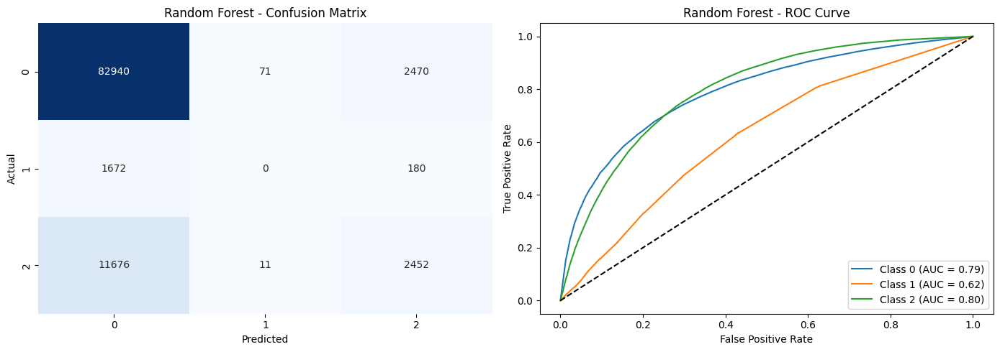


Logistic Regression - Classification Report:
              precision    recall  f1-score   support

         0.0       0.86      0.98      0.92     85481
         1.0       0.00      0.00      0.00      1852
         2.0       0.52      0.17      0.26     14139

    accuracy                           0.85    101472
   macro avg       0.46      0.38      0.39    101472
weighted avg       0.80      0.85      0.81    101472



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


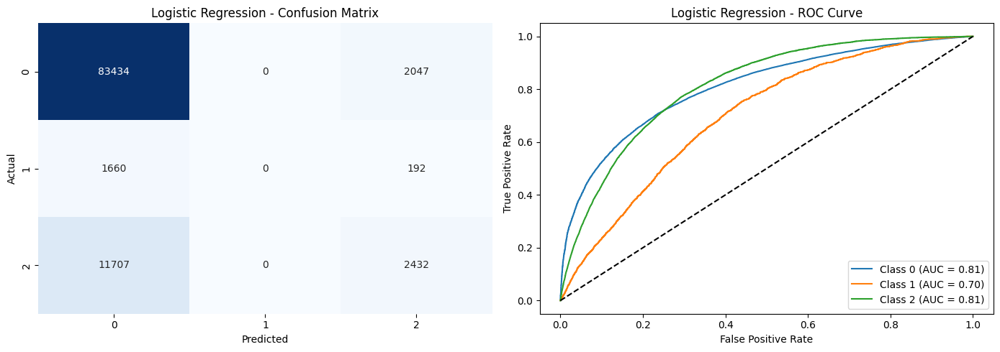


XGBoost - Classification Report:
              precision    recall  f1-score   support

         0.0       0.86      0.98      0.92     85481
         1.0       0.00      0.00      0.00      1852
         2.0       0.53      0.17      0.25     14139

    accuracy                           0.85    101472
   macro avg       0.46      0.38      0.39    101472
weighted avg       0.80      0.85      0.81    101472



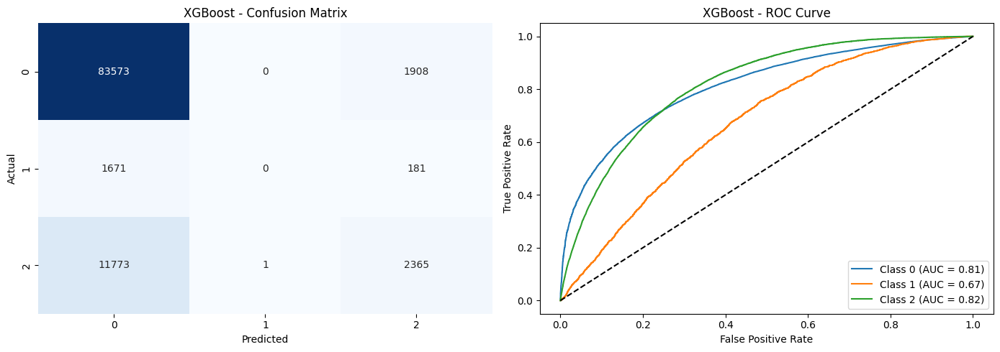


KNN - Classification Report:
              precision    recall  f1-score   support

         0.0       0.86      0.95      0.91     85481
         1.0       0.02      0.00      0.00      1852
         2.0       0.41      0.21      0.28     14139

    accuracy                           0.83    101472
   macro avg       0.43      0.39      0.40    101472
weighted avg       0.79      0.83      0.80    101472



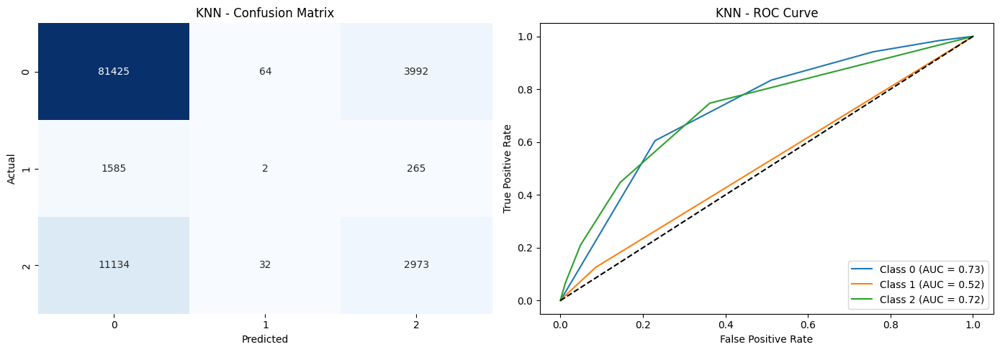


Decision Tree - Classification Report:
              precision    recall  f1-score   support

         0.0       0.87      0.86      0.87     85481
         1.0       0.02      0.03      0.02      1852
         2.0       0.29      0.31      0.30     14139

    accuracy                           0.77    101472
   macro avg       0.40      0.40      0.40    101472
weighted avg       0.78      0.77      0.77    101472



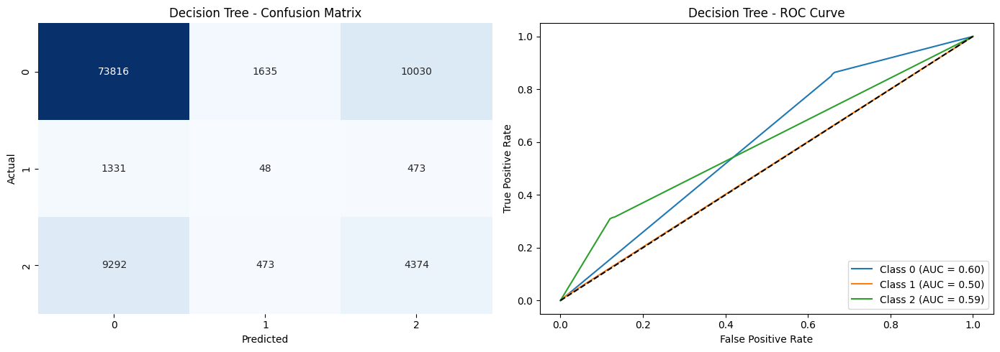


Naive Bayes - Classification Report:
              precision    recall  f1-score   support

         0.0       0.87      0.95      0.91     85481
         1.0       0.00      0.00      0.00      1852
         2.0       0.42      0.25      0.31     14139

    accuracy                           0.83    101472
   macro avg       0.43      0.40      0.41    101472
weighted avg       0.79      0.83      0.81    101472



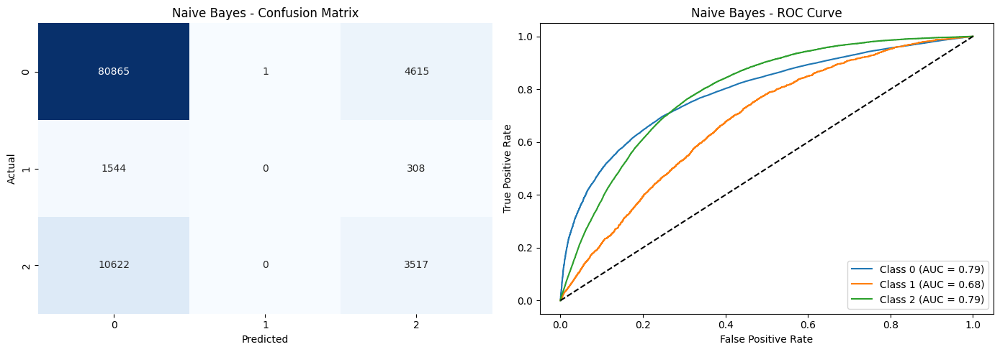


Neural Network - Classification Report:
              precision    recall  f1-score   support

         0.0       0.85      0.99      0.92     85481
         1.0       0.00      0.00      0.00      1852
         2.0       0.59      0.10      0.17     14139

    accuracy                           0.85    101472
   macro avg       0.48      0.36      0.36    101472
weighted avg       0.80      0.85      0.80    101472



/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


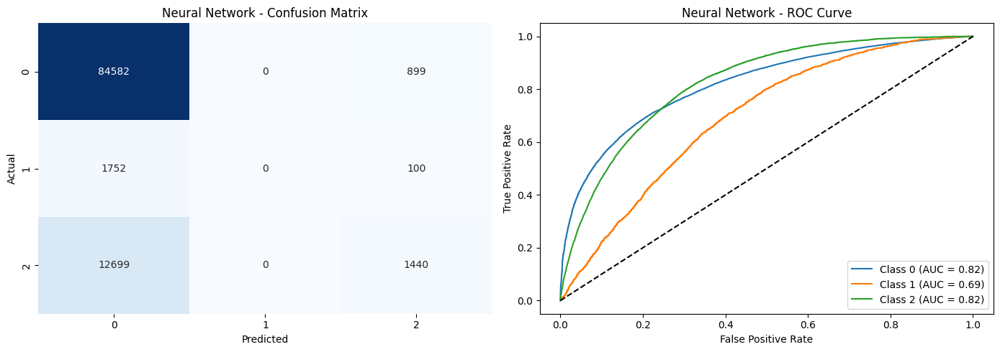


Voting Classifier - Classification Report:


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

         0.0       0.86      0.98      0.92     85481
         1.0       0.00      0.00      0.00      1852
         2.0       0.55      0.16      0.25     14139

    accuracy                           0.85    101472
   macro avg       0.47      0.38      0.39    101472
weighted avg       0.80      0.85      0.81    101472



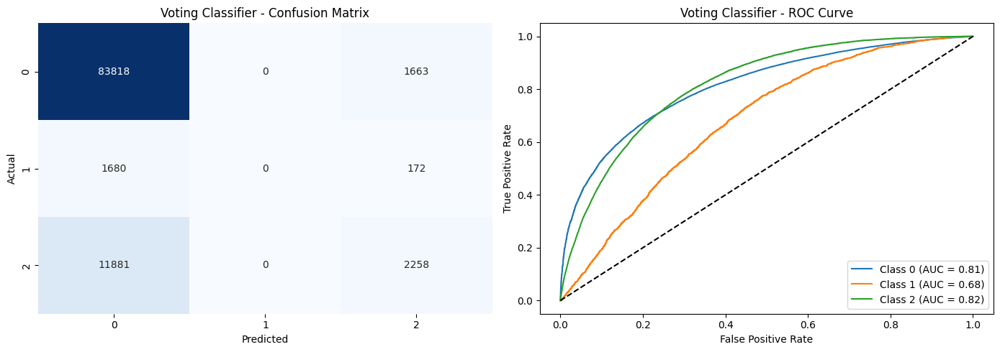


Stacking Classifier - Classification Report:


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

         0.0       0.87      0.97      0.92     85481
         1.0       0.00      0.00      0.00      1852
         2.0       0.52      0.20      0.29     14139

    accuracy                           0.85    101472
   macro avg       0.46      0.39      0.40    101472
weighted avg       0.80      0.85      0.81    101472



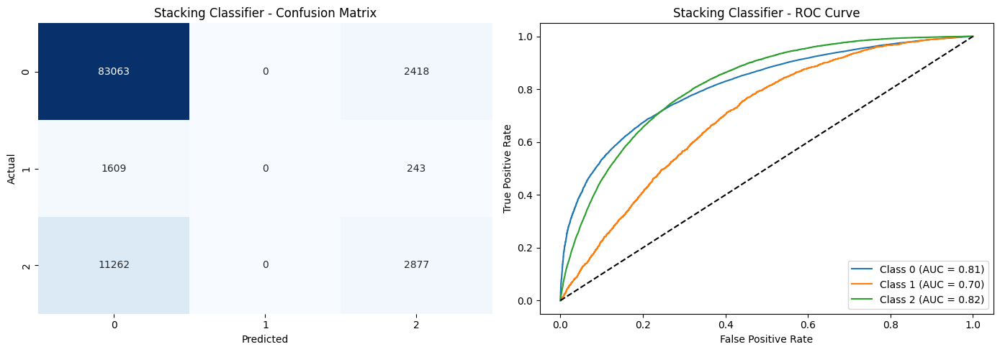

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, roc_curve, auc

def plot_confusion_matrix_and_roc(model_name, model, X_test, y_test):
    """
    Plots the confusion matrix with metrics and ROC curve for a given model.
    """
    fig, axes = plt.subplots(1, 2, figsize=(14, 5))

    # Confusion Matrix
    cm = results[model_name]["Confusion Matrix"]
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False, ax=axes[0])
    axes[0].set_title(f"{model_name} - Confusion Matrix")
    axes[0].set_xlabel('Predicted')
    axes[0].set_ylabel('Actual')

    # Display Confusion Matrix metrics
    print(f"\n{model_name} - Classification Report:")
    print(classification_report(y_test, model.predict(X_test)))

    # ROC Curve
    if hasattr(model, "predict_proba"):
        y_proba = model.predict_proba(X_test)
        for i in range(y_proba.shape[1]):
            fpr, tpr, _ = roc_curve(y_test, y_proba[:, i], pos_label=i)
            roc_auc = auc(fpr, tpr)
            axes[1].plot(fpr, tpr, label=f'Class {i} (AUC = {roc_auc:.2f})')

        axes[1].plot([0, 1], [0, 1], 'k--')
        axes[1].set_xlabel('False Positive Rate')
        axes[1].set_ylabel('True Positive Rate')
        axes[1].set_title(f"{model_name} - ROC Curve")
        axes[1].legend(loc="lower right")
    else:
        axes[1].text(0.5, 0.5, "No probability estimates available",
                     horizontalalignment='center', verticalalignment='center',
                     fontsize=12, color='red')
        axes[1].set_title(f"{model_name} - No ROC Curve")

    plt.tight_layout()
    plt.show()


# ✅ Call the function for each model
for model_name, model in models.items():
    plot_confusion_matrix_and_roc(model_name, model, X_test, y_test)


In [ ]:
# Display the table
from IPython.display import display
results_df = pd.DataFrame.from_dict(results, orient='index')
display(results_df)


,Accuracy,Precision,Recall,F1 Score,Balanced Accuracy,Average Precision,ROC AUC,Confusion Matrix
Random Forest,0.841533,0.792596,0.841533,0.804286,0.381232,0.850462,0.790719,"[[82940, 71, 2470], [1672, 0, 180], [11676, 11..."
Logistic Regression,0.846204,0.798632,0.846204,0.807206,0.382687,0.860759,0.807323,"[[83434, 0, 2047], [1660, 0, 192], [11707, 0, ..."
XGBoost,0.846913,0.799661,0.846913,0.806992,0.381649,0.862619,0.809955,"[[83573, 0, 1908], [1671, 0, 181], [11773, 1, ..."
KNN,0.831757,0.786268,0.831757,0.802547,0.387967,0.808991,0.722789,"[[81425, 64, 3992], [1585, 2, 265], [11134, 32..."
Decision Tree,0.771030,0.777802,0.771030,0.774359,0.399604,0.759029,0.596088,"[[73816, 1635, 10030], [1331, 48, 473], [9292,..."
Naive Bayes,0.831579,0.790308,0.831579,0.806622,0.398248,0.849446,0.787996,"[[80865, 1, 4615], [1544, 0, 308], [10622, 0, ..."
Neural Network,0.847741,0.801751,0.847741,0.796535,0.363776,0.866307,0.816864,"[[84582, 0, 899], [1752, 0, 100], [12699, 0, 1..."
Voting Classifier,0.848273,0.801965,0.848273,0.806789,0.380082,0.863291,0.810469,"[[83818, 0, 1663], [1680, 0, 172], [11881, 0, ..."
Stacking Classifier,0.846933,0.801774,0.846933,0.812160,0.391731,0.863495,0.811470,"[[83063, 0, 2418], [1609, 0, 243], [11262, 0, ..."
SVC (Linear),0.278205,0.698027,0.278205,0.386613,0.306628,0.770735,0.613457,NaN
